# New York taxi trip duration EDA
in this EDA we will be exploring  project-nyc-taxi-trip-duration which can found [here](project-nyc-taxi-trip-duration) 
# Table of Contents

1.  [Important Considerations before start](#important-considerations)
2.  [libraries we will use](#libraries-we-will-use)
3.  [loading New York City Taxi Trip Duration](#loading-New-York-City-Taxi-Trip-Duration)
   
   *   [Data info](#Data-info)
   *   [what to drop?](#what-to-drop?)
   *   [looking into the null data](#looking-into-the-null-data)
   *   [now let's visualize some data](#now-let's-visualize-some-data)
   *   [what about the time of the day?](#what-about-the-time-of-the-day?)
   *   [checking each month separately](#checking-each-month-separately)
   *   [investiagating vendor id ](#investiagating-vendor-id )
   *  [some feature enginnering to extract more meaningful features](#some-feature-enginnering-to-extract-more-meaningful-features)
   
3. [features using osrm api](#features-using-osrm-api)
  
4. [checking correlation matrix](#let's-check-the-corrolation-matrix-again)
  
5. [Borough Data](#another-important-factor-that-could-affect-the-trip-duration-is-the-pickup-and-dropoff-location)
  
6. [Traffic Volume Data ](#let's-investigate-Traffic-volume-data)

7. [Weather Data Set](#now-for-the-weather)

8. [a final look to the correlation matrix ](#a-final-look-to-the-correlation-matrix)

9. [What could be enhanced ](#What-could-be-enhanced)
     

# important considerations 
- We will not focus on model regularisation or workarounds or trying different models (this is usually a mechanical process ), instead we will be focusing on feature engineering 
- There are a couple of external data sets we are using alongside this data, so make sure they are downloaded and set up correctly
	1. Automated Traffic Volume, which can be  found [here](https://catalog.data.gov/dataset/automated-traffic-volume-counts#:~:text=New%20York%20City%20Department%20of,vary%20from%20year%20to%20year)
	2.  Weather data in New York City - 2016, which can be found [here](https://www.kaggle.com/datasets/mathijs/weather-data-in-new-york-city-2016)
	3. Borough Boundaries for New York City, which can be found [here](https://catalog.data.gov/dataset/borough-boundaries-a8eb4#:~:text=Metadata%20Updated%3A%20April%2012%2C%202025)
	4. New York data from geofabrik,  which can be downloaded from [here](https://download.geofabrik.de/north-america/us/new-york.html) _the osm.pbf file_
		1. Queering this file with start location (longitude, latitude) and end location(longitude, latitude) will return the expected time needed in seconds based on [open street map](https://wiki.openstreetmap.org/wiki/API). I will be attaching a file on how to set it up 
		2. We will need to build a Docker image for this file to be able to query it. If you don't want, you can skip features related to it, which have  **osrm** with it
- I will be adding a requirements.txt file, make sure you pip install it before running the EDA to download all dependencies 



# libraries we will use 

In [1]:
import folium
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import holidays
from geopy import distance
from sklearn.preprocessing import OneHotEncoder
import seaborn as sns
import requests
from shapely import wkt
from shapely import Point
import astral
from astral import LocationInfo
from astral.sun import sun
from astral import Observer
import datetime
from matplotlib.gridspec import GridSpec
from astral.geocoder import database, lookup
from astral import LocationInfo
from astral.sun import sun
import datetime

# for formatting the cel
import black

import jupyter_black

jupyter_black.load(
    line_length=130,
    verbosity="DEBUG",
    target_version=black.TargetVersion.PY310,
)
# Uncomment the line below for the first time use
%load_ext jupyter_black
# %reload_ext jupyter_black
sns.set_theme(style="white")
sns.set_palette("hot")
sns.set(rc={"figure.dpi": 600})  # you don't need to do this

DEBUG:jupyter_black:config: {'line_length': 130, 'target_versions': {<TargetVersion.PY310: 10>}}


# loading New York City Taxi Trip Duration


In [2]:
# laoding the train sample
path = "Data_From_kaggle/train.csv"
data = pd.read_csv(path)
data.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,N,455
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,N,663
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,N,2124
3,id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010040,40.719971,-74.012268,40.706718,N,429
4,id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973053,40.793209,-73.972923,40.782520,N,435


## Data info 

- **id**: a unique identifier for each trip
- **vendor_id** - a code indicating the provider associated with the trip record
- **pickup_datetime** - date and time when the meter was engaged
- **dropoff_datetime** - date and time when the meter was disengaged
- **passenger_count** - the number of passengers in the vehicle (driver entered value)
- **pickup_longitude** - the longitude where the meter was engaged
- **pickup_latitude** - the latitude where the meter was engaged
- **dropoff_longitude** - the longitude where the meter was disengaged
- **dropoff_latitude** - the latitude where the meter was disengaged
- **store_and_fwd_flag** - This flag indicates whether the trip record was held in vehicl
- **memory** before sending to the vendor because the vehicle did not have a connection to th server - Y=store and forward; N=not a store and forward trip
- **trip_duration** - duration of the trip in seconds

## what to drop?
before anything there are couple of columns that are not related to the dependent variable such as 
- **id**
- **dropoff_datetime**  just to make things little exciting !
## let's dig deepeer into the data


In [3]:
drop_features = ["id", "dropoff_datetime"]

# dropping columns
data.drop(drop_features, axis=1, inplace=True)

# examining the data type for each columns
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1458644 entries, 0 to 1458643
Data columns (total 9 columns):
 #   Column              Non-Null Count    Dtype  
---  ------              --------------    -----  
 0   vendor_id           1458644 non-null  int64  
 1   pickup_datetime     1458644 non-null  object 
 2   passenger_count     1458644 non-null  int64  
 3   pickup_longitude    1458644 non-null  float64
 4   pickup_latitude     1458644 non-null  float64
 5   dropoff_longitude   1458644 non-null  float64
 6   dropoff_latitude    1458644 non-null  float64
 7   store_and_fwd_flag  1458644 non-null  object 
 8   trip_duration       1458644 non-null  int64  
dtypes: float64(4), int64(3), object(2)
memory usage: 100.2+ MB


## looking into the null data 

In [4]:
data.isnull().sum()

vendor_id             0
pickup_datetime       0
passenger_count       0
pickup_longitude      0
pickup_latitude       0
dropoff_longitude     0
dropoff_latitude      0
store_and_fwd_flag    0
trip_duration         0
dtype: int64

__ther is no null data ,which is good__

The next logical thing to do is to set up the correct data types in the data , let's start with the objects .

- `pickup_datetime` 
    - We know form the data card that it's suppoed to be a date so let's convert it 
- `store_and_fwd_flag` 
    - we also know that this is suppoed to be a string 'Y' or 'N' so let's convert it also 
 

In [5]:
data["pickup_datetime"] = pd.to_datetime(data["pickup_datetime"])
data["store_and_fwd_flag"] = data["store_and_fwd_flag"].astype(str)
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1458644 entries, 0 to 1458643
Data columns (total 9 columns):
 #   Column              Non-Null Count    Dtype         
---  ------              --------------    -----         
 0   vendor_id           1458644 non-null  int64         
 1   pickup_datetime     1458644 non-null  datetime64[ns]
 2   passenger_count     1458644 non-null  int64         
 3   pickup_longitude    1458644 non-null  float64       
 4   pickup_latitude     1458644 non-null  float64       
 5   dropoff_longitude   1458644 non-null  float64       
 6   dropoff_latitude    1458644 non-null  float64       
 7   store_and_fwd_flag  1458644 non-null  object        
 8   trip_duration       1458644 non-null  int64         
dtypes: datetime64[ns](1), float64(4), int64(3), object(1)
memory usage: 100.2+ MB


## now let's visualize some data
- let's start with the `pickup_datetime`
   we want to know
  - the range of dates we have
  - frequency of trips for each month
  - frequency of the trips with in each month 

<Axes: xlabel='pickup_datetime', ylabel='Count'>

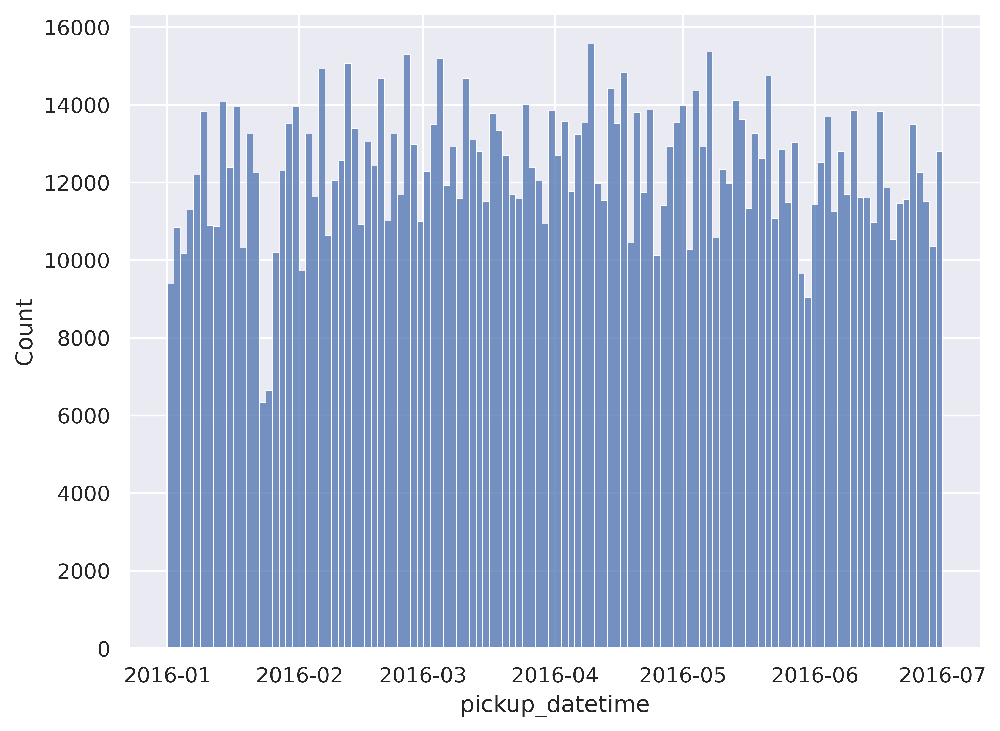

In [6]:
ax = plt.subplots(figsize=(8, 6))
sns.histplot(data, x="pickup_datetime")

as you can see we have a nice smooth almost uniform for the trips for each month [1 , 2 ,3 ,4, 5 ,6  ,7]

we can check this further  if we want !  that's why we will need to extract some features from the `pickup_datetime` to hlep use to do some analysis 

__so the below features is no thing but__
- day  : the day of the tirp
- month  : at which month
- _year_ will be unnecessary since the data is all around 2016
- hour : at which hour was the trip 
- minute : minute of the tirp
- the day of the week : at which day of the week 
- week of the month : at which week with respect to the current month 1.st ,2.nd ,3.rd , 4.th 
- week of the year  : at which week with respect to the year (year has 4*12 =48)
- quartile: which quarter of the year , the year has 4 quarters)

In [7]:
# getting some features out from the pickup_datetime
data["month"] = data["pickup_datetime"].apply(lambda x: x.month)
data["day"] = data["pickup_datetime"].apply(lambda x: x.day)
data["hour"] = data["pickup_datetime"].apply(lambda x: x.hour)
data["minute"] = data["pickup_datetime"].apply(lambda x: x.minute)
data["week"] = data["pickup_datetime"].apply(lambda x: x.week)
data["week_day"] = data["pickup_datetime"].apply(lambda x: x.day_of_week)
data["week_of_year"] = data["pickup_datetime"].apply(lambda x: x.weekofyear)
data["quarter"] = data["pickup_datetime"].apply(lambda x: x.quarter)

[Text(1, 0, 'January'),
 Text(2, 0, 'February'),
 Text(3, 0, 'March'),
 Text(4, 0, 'April'),
 Text(5, 0, 'May'),
 Text(6, 0, 'June')]

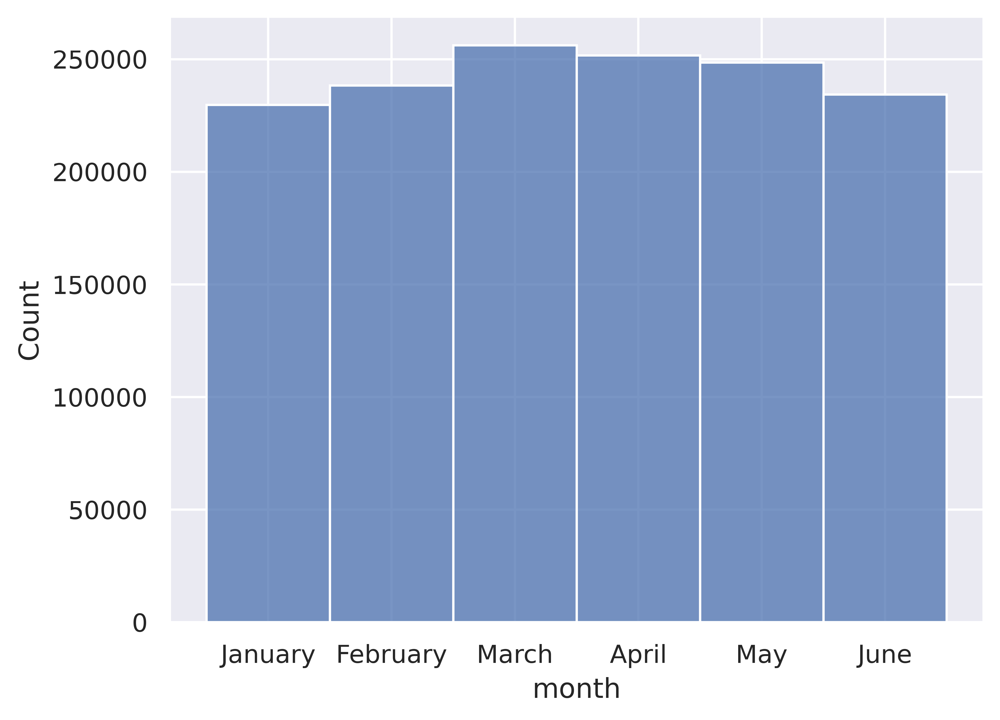

In [8]:
months = [
    "January",
    "February",
    "March",
    "April",
    "May",
    "June",
    "July",
    "August",
    "September",
    "October",
    "November",
    "December",
]


ax = sns.histplot(data, x="month", discrete=True, kde=False)
ticks = ax.get_xticks()
ax.set_xticks(range(1, 7))
ax.set_xticklabels(months[:6])

## what about the time of the day? 

Text(0.5, 0, 'boxen plot of hours')

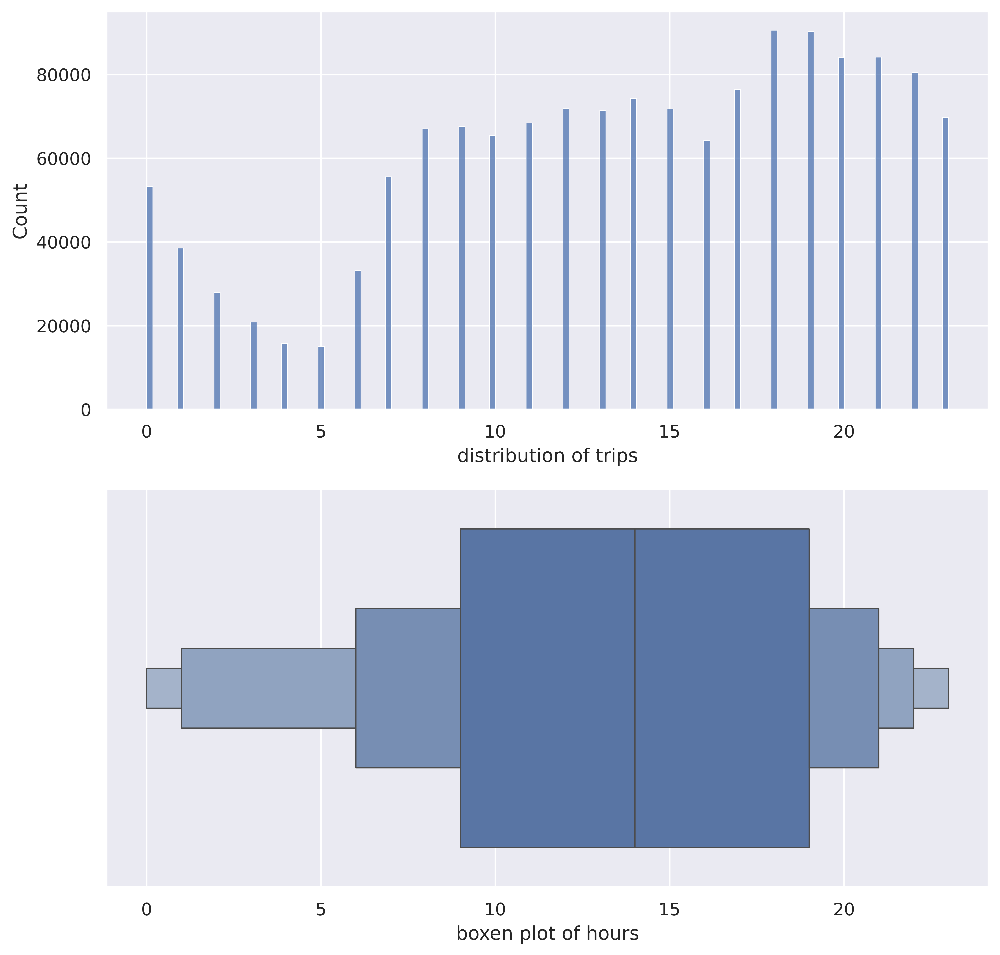

In [9]:
fig, ax = plt.subplots(2, 1, figsize=(10, 10))

sns.histplot(data, x="hour", ax=ax[0])
sns.boxenplot(data, x="hour", ax=ax[1])
ax[0].set_xlabel("distribution of trips")
ax[1].set_xlabel("boxen plot of hours")

## Two observations from above
1. Most of the tips are centred around 15 H
2. Few trips form 0 to 5, which is reasonable

## interaction between the trip duration and individual time periods(day,month,hour)

/tmp/ipykernel_233966/2480875977.py:3: UserWarning: The palette list has more values (24) than needed (6), which may not be intended.
  sns.boxenplot(


<Axes: xlabel='hour', ylabel='trip_duration'>

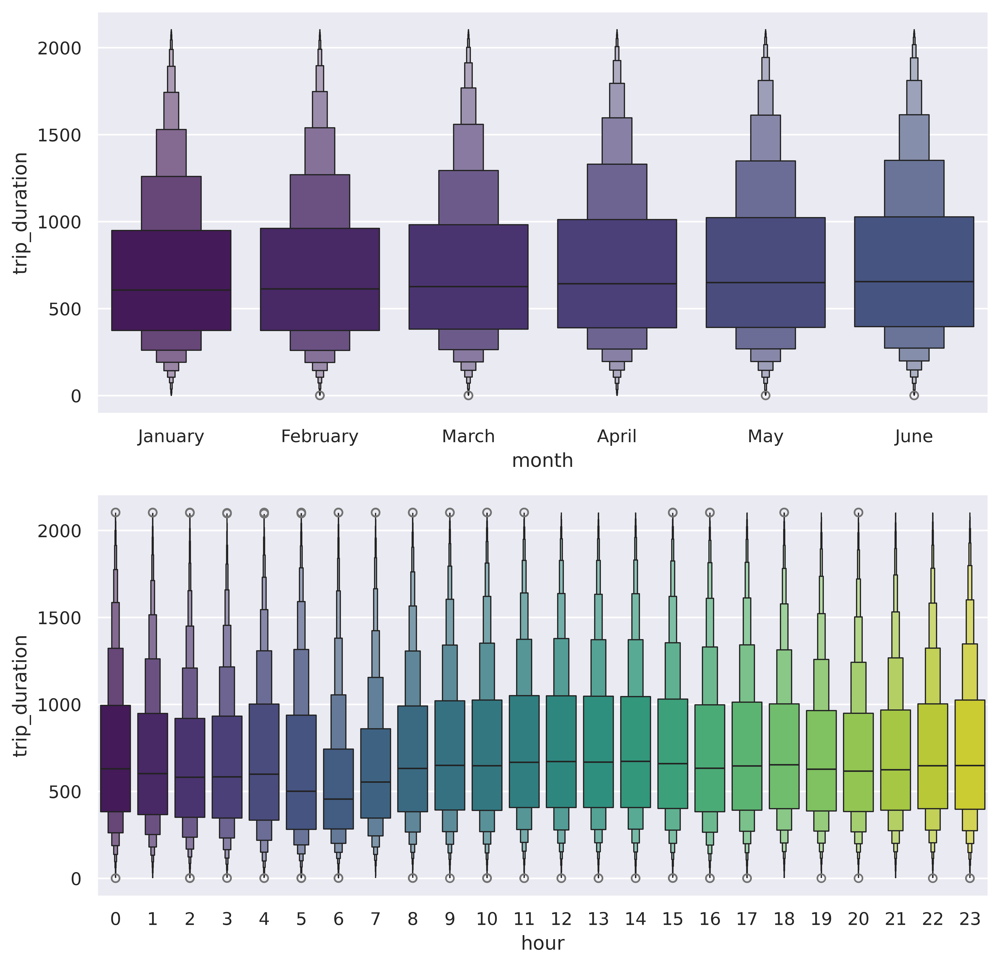

In [10]:
colors = sns.color_palette("viridis", 24)
fig, ax = plt.subplots(2, 1, figsize=(10, 10))
sns.boxenplot(
    data[data.trip_duration <= data.trip_duration.quantile(0.95)],
    x="month",
    y="trip_duration",
    ax=ax[0],
    palette=colors,
    hue="month",
    legend=False,
)

ax[0].set_xticks(range(0, 6))
ax[0].set_xticklabels(months[:6])
sns.boxenplot(
    data[data.trip_duration <= data.trip_duration.quantile(0.95)],
    x="hour",
    y="trip_duration",
    ax=ax[1],
    palette=colors,
    hue="hour",
    legend=False,
)

As you can see 
- We have almost a constant trip average across months
- and a slight variation of the mean concerning the hour (with a lower mean for the early hours of the day, especially 5, 6)
## checking each month separately

<Axes: xlabel='day', ylabel='trip_duration'>

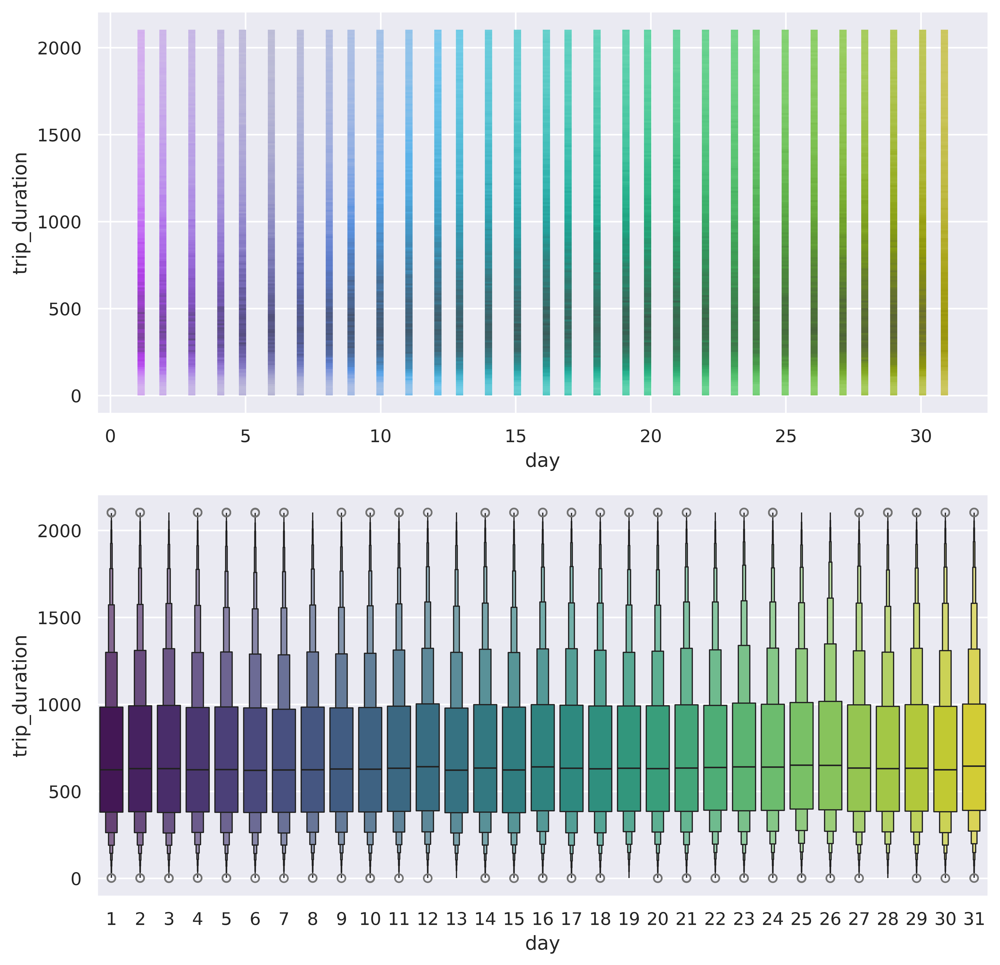

In [11]:
colors = sns.color_palette("viridis", 31)
fig, ax = plt.subplots(2, 1, figsize=(10, 10))
sns.histplot(
    data[data.trip_duration <= data.trip_duration.quantile(0.95)],
    x="day",
    y="trip_duration",
    ax=ax[0],
    palette=colors,
    hue="day",
    legend=False,
)

sns.boxenplot(
    data[data.trip_duration <= data.trip_duration.quantile(0.95)],
    x="day",
    y="trip_duration",
    ax=ax[1],
    palette=colors,
    hue="day",
    legend=False,
)

As you can see, we have almost constant trip average across days, there is no dramatic shift among days 
## Investigating vendor ID 
- Start with identifying the range  of IDs
- effect of each over the trip duration, if any 

In [12]:
data.vendor_id.unique()

array([2, 1])

which indicates we have 2 separate companies or vendors! 
__now let's see if there is any noticeable change between them ?__
- We will get the average trip duration for each one
- How many passengers on average does each one take
- How many trips does each one take per day ( are there any peak hours or not? )

In [13]:
for vendor in data.vendor_id.unique():
    print(
        "average trip duration for vendor",
        vendor,
        "is ",
        np.average(data[data.vendor_id == vendor].trip_duration),
    )

average trip duration for vendor 2 is  1058.6431638006823
average trip duration for vendor 1 is  845.4382435408687


Well, there is indeed a change in the average trip duration __but don't forget that this is in seconds!__  we need to investigate further to find out if this difference is of  statistical  significance or not 

In [14]:
fig, ax = plt.subplots(2, 1, figsize=(15, 15))
filtered_data = data[data["trip_duration"] <= data["trip_duration"].quantile(0.95)]
vendor1_data = filtered_data[filtered_data["vendor_id"] == 1]
vendor2_data = filtered_data[filtered_data["vendor_id"] == 2]


sns.kdeplot(vendor1_data, x="month", y="trip_duration", ax=ax[0], palette="hot")
sns.kdeplot(vendor2_data, x="month", y="trip_duration", ax=ax[0], palette="hot")
ax[0].legend(title="vendors", labels=["vendor1", "vendor2"])


sns.kdeplot(vendor1_data, x="trip_duration", ax=ax[1], fill=True, palette="hot")
sns.kdeplot(vendor2_data, x="trip_duration", ax=ax[1], fill=True, palette="hot")
ax[1].legend(title="vendors", labels=["vendor1", "vendor2"])

/tmp/ipykernel_233966/93383776.py:7: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.kdeplot(vendor1_data, x="month", y="trip_duration", ax=ax[0], palette="hot")
/tmp/ipykernel_233966/93383776.py:8: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.kdeplot(vendor2_data, x="month", y="trip_duration", ax=ax[0], palette="hot")
/tmp/ipykernel_233966/93383776.py:12: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.kdeplot(vendor1_data, x="trip_duration", ax=ax[1], fill=True, palette="hot")
/tmp/ipykernel_233966/93383776.py:13: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.kdeplot(vendor2_data, x="trip_duration", ax=ax[1], fill=True, palette="hot")


__as you can see from the plots above__
- For the distributions of each month, there are almost identical
- for the overall distribution of the `trip_duration` also there is also no difference.
_these all are indicators that this column is so far irrelevant_ but let's see if there is a difference between them in the `passenger_count`


<Axes: xlabel='passenger_count', ylabel='count'>

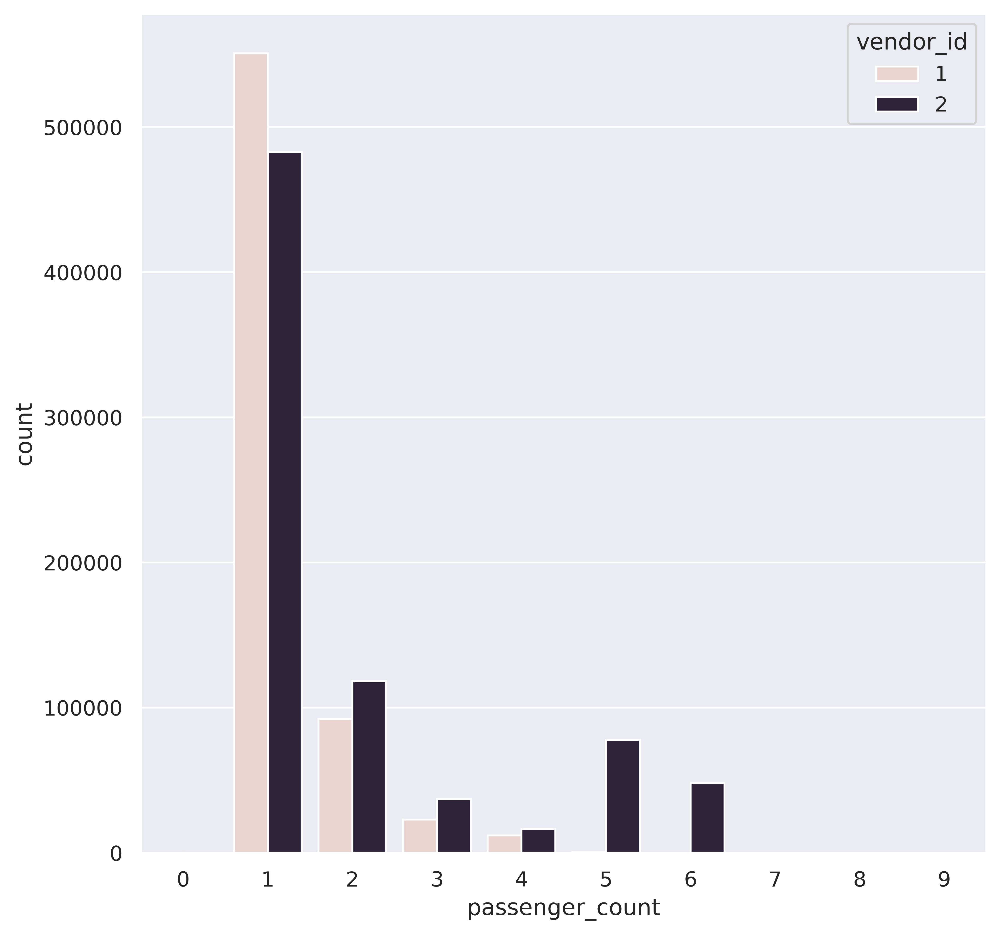

In [15]:
fig, ax = plt.subplots(figsize=(8, 8))
sns.countplot(data=data, x="passenger_count", hue="vendor_id", ax=ax)

__we can see that `vendor 2` tends to take a large number of passengers__ and we can prove it below 

In [16]:
for vendor in data.vendor_id.unique():
    print(
        "vendor",
        vendor,
        "takes",
        data[data.vendor_id == vendor]["passenger_count"].value_counts(),
    )

vendor 2 takes passenger_count
1    482753
2    118176
5     77744
6     48181
3     36954
4     16460
0        29
7         3
9         1
8         1
Name: count, dtype: int64
vendor 1 takes passenger_count
1    550787
2     92142
3     22942
4     11944
5       344
6       152
0        31
Name: count, dtype: int64


### Vendor 2 is more biased towards taking a larger number of passengers 
As you can see, if we compare 6, for example, we will find that 
- Vendor 2 takes 48181
- Vendor 1 takes 152


## some feature enginnering to extract more meaningful features
1. `weekend_status` binary indicator for weather the current day is a week end or not
2. some cyclyc features like `hour_sin` `hour_cos` `minute_sin``minute_cos` `week_sin` `week_cos` `week_of_year_sin` `week_of_year_cos` these are exactly as the name suggests just to help the model to idenitfy the cyclic nature of the time 

In [17]:
data["weekend_status"] = data["pickup_datetime"].apply(lambda x: 1 if x.day_name() in ("Saturday", "Sunday") else 0)
# holiday or not
us_holidays = holidays.US()

data["is_holiday"] = data["pickup_datetime"].apply(lambda x: 1 if x.date() in us_holidays else 0)

# cyclic features
data["hour_sin"] = np.sin(2 * np.pi * data["hour"] / 24)
data["hour_cos"] = np.cos(2 * np.pi * data["hour"] / 24)
data["minute_sin"] = np.sin(2 * np.pi * data["minute"] / 60)
data["minute_cos"] = np.cos(2 * np.pi * data["minute"] / 60)
data["week_sin"] = np.sin(2 * np.pi * data["week"] / 4)
data["week_cos"] = np.cos(2 * np.pi * data["week"] / 4)
data["week_of_year_sin"] = np.sin(2 * np.pi * data["week_of_year"] / 48)
data["week_of_year_cos"] = np.cos(2 * np.pi * data["week_of_year"] / 48)
data.head()

,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,month,...,weekend_status,is_holiday,hour_sin,hour_cos,minute_sin,minute_cos,week_sin,week_cos,week_of_year_sin,week_of_year_cos
0,2,2016-03-14 17:24:55,1,-73.982155,40.767937,-73.964630,40.765602,N,455,3,...,0,0,-0.965926,-0.258819,5.877853e-01,-0.809017,-1.000000e+00,-2.449913e-15,0.991445,1.305262e-01
1,1,2016-06-12 00:43:35,1,-73.980415,40.738564,-73.999481,40.731152,N,663,6,...,1,0,0.000000,1.000000,-9.781476e-01,-0.207912,-1.000000e+00,-3.184701e-15,0.130526,-9.914449e-01
2,2,2016-01-19 11:35:24,1,-73.979027,40.763939,-74.005333,40.710087,N,2124,1,...,0,0,0.258819,-0.965926,-5.000000e-01,-0.866025,-1.000000e+00,-1.836970e-16,0.382683,9.238795e-01
3,2,2016-04-06 19:32:31,1,-74.010040,40.719971,-74.012268,40.706718,N,429,4,...,0,0,-0.965926,0.258819,-2.079117e-01,-0.978148,8.572528e-16,-1.000000e+00,0.965926,-2.588190e-01
4,2,2016-03-26 13:30:55,1,-73.973053,40.793209,-73.972923,40.782520,N,435,3,...,1,0,-0.258819,-0.965926,5.665539e-16,-1.000000,-7.347881e-16,1.000000e+00,1.000000,6.123234e-17


<Axes: xlabel='trip_duration', ylabel='Density'>

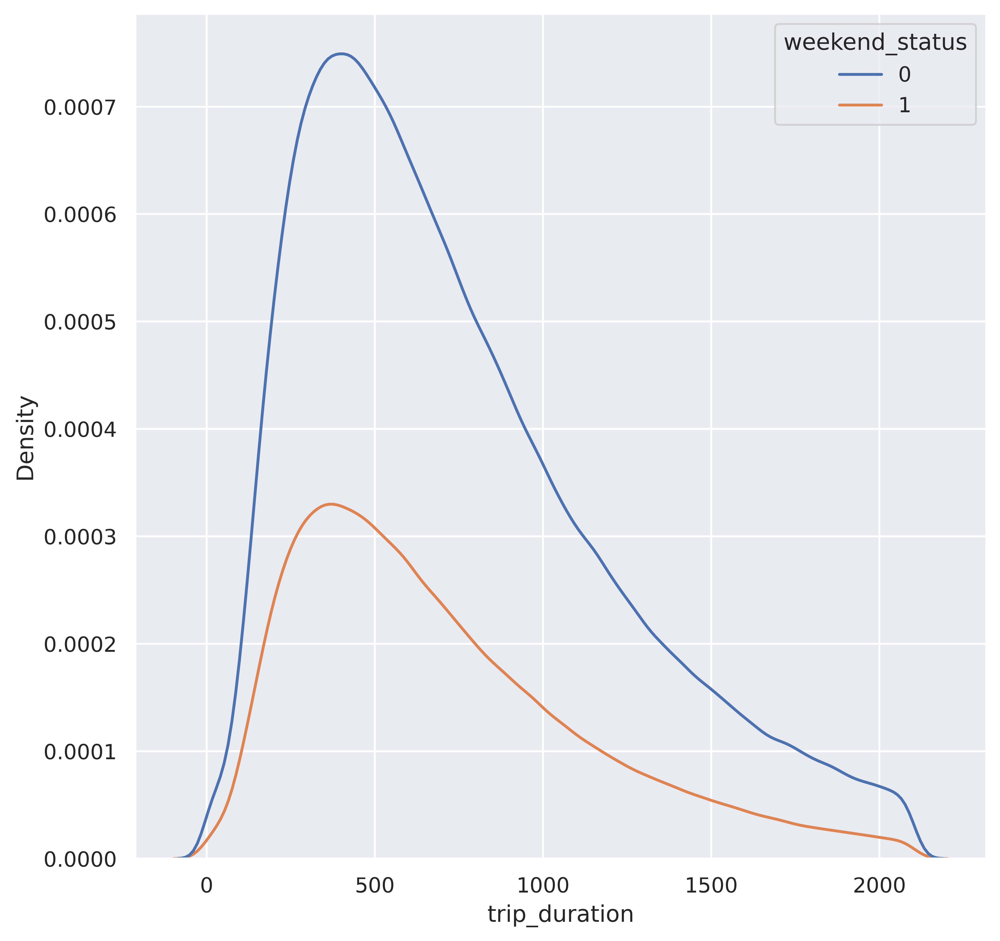

In [18]:
fig, ax = plt.subplots(figsize=(8, 8))
sns.kdeplot(
    data[data.trip_duration <= data.trip_duration.quantile(0.95)],
    x="trip_duration",
    hue="weekend_status",
    ax=ax,
)

### as you can see, trips on the weekend tend to be longer.  We can prove this analytically also below   
__also using violin plots below__ 

In [19]:
for status in data.weekend_status.unique():
    print(
        "average  trip duration for  weekend status = ",
        bool(status),
        np.average(data[data.weekend_status == status]["trip_duration"]),
    )

average  trip duration for  weekend status =  False 972.7590851968035
average  trip duration for  weekend status =  True 926.2670733289448


<Axes: xlabel='weekend_status', ylabel='trip_duration'>

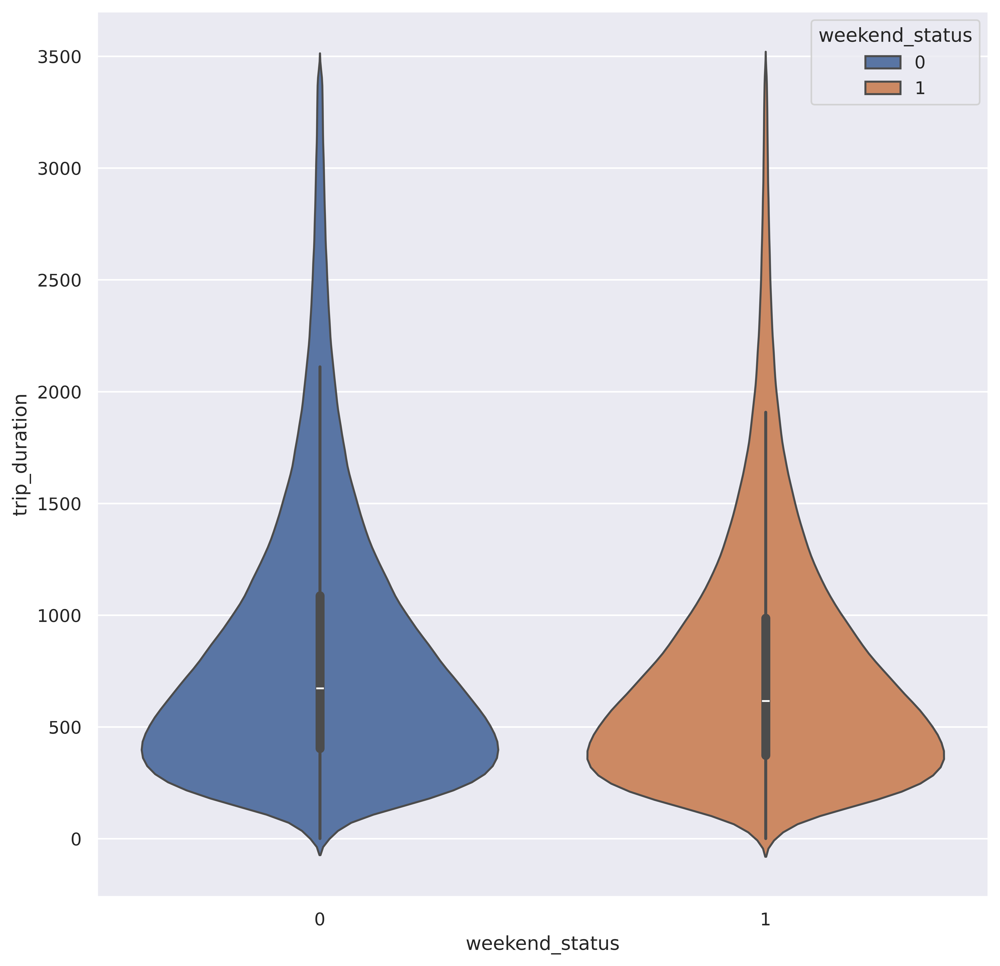

In [20]:
filtered_data = data[data.trip_duration <= data.trip_duration.quantile(0.99)]  # tinker with this value

fig, ax = plt.subplots(figsize=(10, 10))
sns.violinplot(
    data=filtered_data,
    x="weekend_status",
    y="trip_duration",
    hue="weekend_status",
    ax=ax,
)

## Another useful feature could be related to what part of the day the trip was  
- morning or afternoon , afternoon  , evening, or night
- Another useful feature could be how much daylight in this day!
-----------------------

In [21]:
# print(lookup('New York', database())) look up the New York City to git it's location info from the library

city = LocationInfo(
    name="New York",
    region="USA",
    timezone="US/Eastern",
    latitude=40.71666666666667,
    longitude=-74.0,
)

s = sun(city.observer, date=datetime.date(2016, 1, 1))
print(
    (
        f'Dawn:    {s["dawn"]}\n'  # each is a datetime object
        f'Sunrise: {s["sunrise"]}\n'
        f'Noon:    {s["noon"]}\n'
        f'Sunset:  {s["sunset"]}\n'
        f'Dusk:    {s["dusk"]}\n'
    )
)
print(s["sunset"] - s["sunrise"])  # <class 'datetime.timedelta'

Dawn:    2016-01-01 11:48:51.263499+00:00
Sunrise: 2016-01-01 12:20:16.556753+00:00
Noon:    2016-01-01 16:59:04+00:00
Sunset:  2016-01-01 21:38:41.443901+00:00
Dusk:    2016-01-01 22:10:06.984342+00:00

9:18:24.887148


In [22]:
def daylight_minutes(row):
    # Extract latitude and longitude from the row
    latitude = row["pickup_latitude"]
    longitude = row["pickup_longitude"]

    # Create an Observer object
    observer = Observer(latitude=latitude, longitude=longitude)

    # date = datetime.date(2016, row['month'], row['day'])
    date = row["pickup_datetime"]
    s = sun(observer, date=date, tzinfo="US/Eastern")

    # Calculate daylight duration
    daylight_duration = s["sunset"] - s["sunrise"]

    # Convert duration to total minutes
    total_minutes = daylight_duration.total_seconds() / 60
    return total_minutes


data["daylight_minutes"] = data.apply(daylight_minutes, axis=1)

## distance between pickup and dropoff locations  

**the next is to calculate the distance between the pick up and the drop off locations**
we can use the Haversine formula or to decice to go with geopy , the give the same results 

In [23]:
# haversine distance which is the same as geo_distance
def getDistanceFromLatLonInKm(lat1, lon1, lat2, lon2):
    R = 6371  # Radius of the earth in km
    dLat = deg2rad(lat2 - lat1)  # deg2rad below
    dLon = deg2rad(lon2 - lon1)
    a = np.sin(dLat / 2) * np.sin(dLat / 2) + np.cos(deg2rad(lat1)) * np.cos(deg2rad(lat2)) * np.sin(dLon / 2) * np.sin(dLon / 2)

    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a))
    d = R * c  # Distance in km
    return d

    def deg2rad(deg):
        return deg * (np.pi / 180)


# data["haversine_distance"] = getDistanceFromLatLonInKm(
#     data["pickup_latitude"],
#     data["pickup_longitude"],
#     data["dropoff_latitude"],
#     data["dropoff_longitude"],
# )


def geo_dist(row):
    return distance.distance(
        (row["pickup_latitude"], row["pickup_longitude"]),
        (row["dropoff_latitude"], row["dropoff_longitude"]),
    ).km


data["geo_dist"] = data.apply(geo_dist, axis=1)

We can see the relation between `geo_dist` and `trip_duration` below 

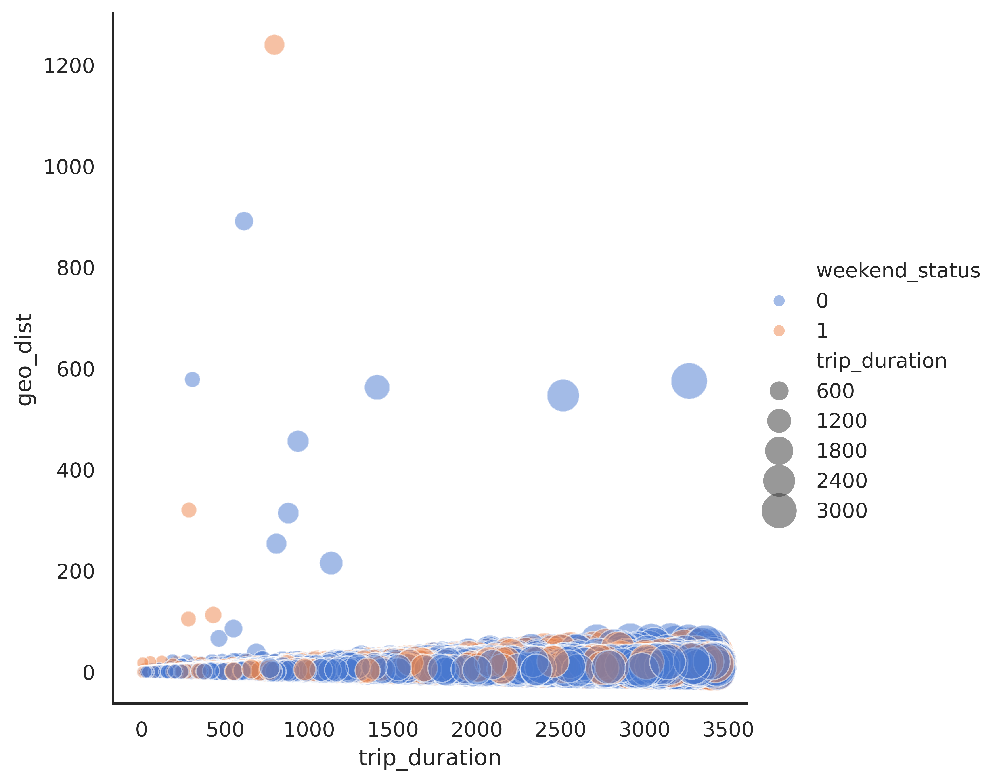

In [24]:
filtered_data = data[data.trip_duration <= data.trip_duration.quantile(0.99)]
# sns.scatterplot(data, x="geo_dist", y="trip_duration")


sns.set_theme(style="white")


# Plot miles per gallon against horsepower with other semantics
sns.relplot(
    x="trip_duration",
    y="geo_dist",
    hue="weekend_status",
    size="trip_duration",
    sizes=(40, 400),
    alpha=0.5,
    palette="muted",
    height=6,
    data=filtered_data,
)

## Other  useful features could be 
- whether the ride is within the rush hours of New York or not!
- ratio between the distance and the number of passengers 
- vertical distance between pick up and drop off 
- horizontal distance between pick up and drop off

In [25]:
def is_rush_hour(row):

    return (
        1
        if 6 <= row["pickup_datetime"].hour <= 10  # morning rush hour
        or 13 <= row["pickup_datetime"].hour <= 20  # afternoon rush hour
        else 0
    )


data["is_rush_hour"] = data.apply(is_rush_hour, axis=1)

# passenger per km
data["passenger_per_geodist"] = data["passenger_count"] / (data["geo_dist"] + 1e-3)


# vertical and horizontal distance
def h_distance(row):
    # 111.3 is the distance between two longitude lines
    return np.abs(row["pickup_longitude"] - row["dropoff_longitude"]) * 111.3


def v_distance(row):
    # 111.3 is the distance between two latitude lines
    return np.abs(row["pickup_latitude"] - row["dropoff_latitude"]) * 111


data["h_distance"] = data.apply(h_distance, axis=1)
data["v_distance"] = data.apply(v_distance, axis=1)

## let's investigate the featreus we have added so far by examining the correlation matrix
- notice , we will look into the `log1p` of `trip_druation` just to minmize the variance , since it's in seconds  or you can just leave it as it's or transform it to hours or better minutes

In [26]:
# def split_data(data):
#     x_train, y_train = (
#         data.drop("trip_duration", axis=1).to_numpy(),
#         np.log1p(data.trip_duration.to_numpy().reshape(-1, 1)), # we
#     )
#     return x_train, y_train

# x_train , y_train = split_data(data)

In [27]:
numeric_data = data.select_dtypes(exclude=["object"])

# Sort the columns of the dataframe
numeric_data.reindex(sorted(numeric_data.columns), axis=1)

corr_matrix = numeric_data.corr()
# fig, ax = plt.subplots(figsize=(22, 22))
# sns.set(font_scale=1)
# sns.heatmap(
#     corr_matrix,
#     annot=True,
#     fmt="0.3f",
#     annot_kws={"size": 10},
#     xticklabels=data.columns,
#     yticklabels=data.columns,
# )


# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(22, 22))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(
    corr_matrix,
    mask=mask,
    cmap=cmap,
    annot=True,
    vmax=0.3,
    center=0,
    annot_kws={"size": 10},
    fmt="0.2f",
    square=True,
    linewidths=0.5,
    cbar_kws={"shrink": 0.5},
)

<Axes: >

## General consideration about correlation matrix 
- correlation matrix captures ONLY the linear relationship between variables, which means if there is a non linear relations ship between them you will have `corr=0` which means that a `corr=0` does not imply there is no relation ship between the variables


## let's visulize the longitude and latitude data 

Text(0, 0.5, 'drop off')

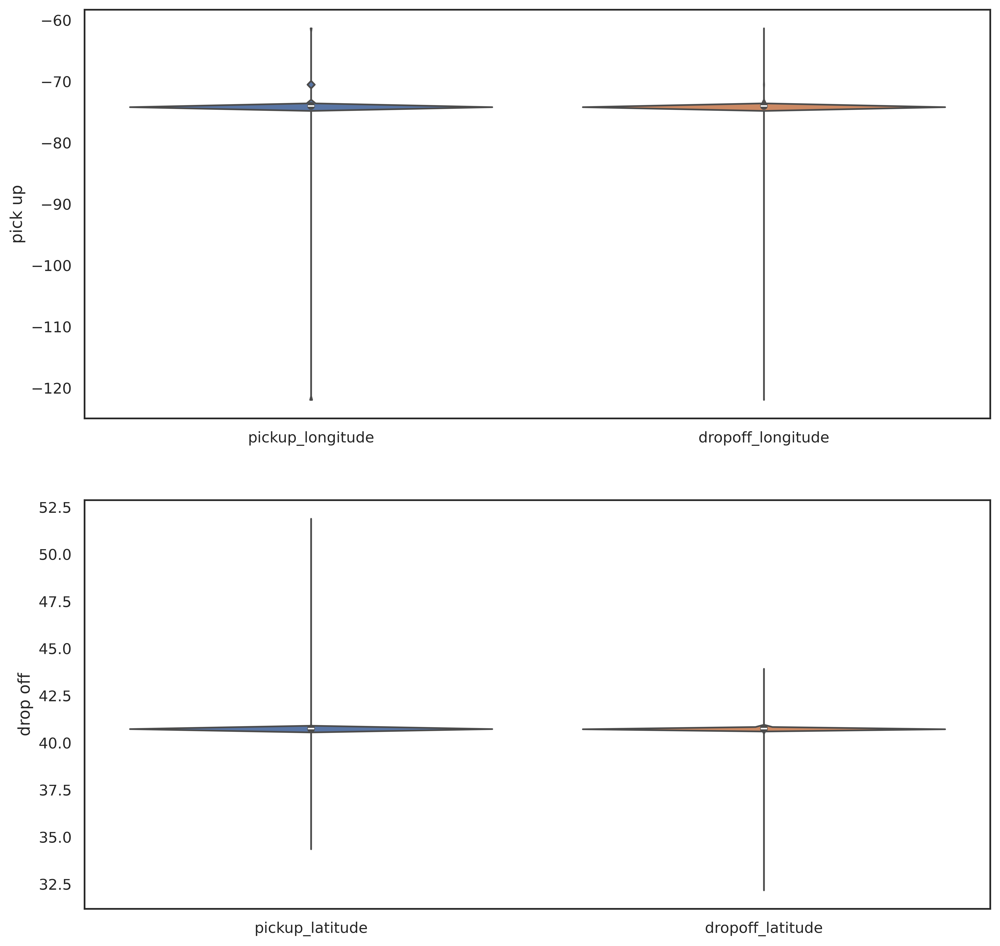

In [28]:
fig, ax = plt.subplots(2, 1, figsize=(12, 12))
sns.violinplot(data[["pickup_longitude", "dropoff_longitude"]], ax=ax[0])
sns.violinplot(data[["pickup_latitude", "dropoff_latitude"]], ax=ax[1])
ax[0].set_ylabel("pick up")
ax[1].set_ylabel("drop off")

__you can see that there are some outliers we will investigate later__
- we can drop these outliers and see the distribution of them  , we will filter the data based on the `geo_dist` which is the distance between 2 points

In [29]:
def filter_outliers(data, filter_column="geo_dist"):
    first_stage = data[data.geo_dist <= data[filter_column].quantile(0.99)]
    second_stage = first_stage[first_stage.geo_dist >= data[filter_column].quantile(0.1)]
    return second_stage


filtered_data = filter_outliers(data)

In [30]:
"geo_dist" in data.columns

True

In [31]:
# sns.boxenplot(filtered_data[['pickup_longitude' , 'dropoff_longitude']])

fig = plt.figure(figsize=(15, 15))

# Define a 2x2 grid
gs = GridSpec(2, 2, figure=fig)
ax1 = fig.add_subplot(gs[0, 0])
sns.violinplot(filtered_data[["pickup_longitude", "dropoff_longitude"]], ax=ax1)
ax2 = fig.add_subplot(gs[1, 0])
sns.violinplot(filtered_data[["pickup_latitude", "dropoff_latitude"]], ax=ax2)
ax1.set_ylabel("pick up")
ax2.set_ylabel("drop off")
ax3 = fig.add_subplot(gs[:, 1])
sns.boxenplot(filtered_data["geo_dist"], ax=ax3)  # just that point around 40 km
ax3.set_xlabel("geo distance")

Text(0.5, 0, 'geo distance')

__as you can see 99% of the data are with in a reasonable range with most of the trips are with in  avery reasonable range around 20km but there are some crazy  trips > 1200km , you can tinker with the `.quanlitle(value)` to see the effect__
we will visualize these outliers on a map  
## Note you can NOT  visualise all this data using folium as it will eat the ram  
 

In [32]:
filtered_data = data[data.geo_dist >= 100]
# gather the pick up (latitude , longitude) points for visualizations
pickup_points = [(row[1].pickup_latitude, row[1].pickup_longitude) for row in filtered_data.iterrows()]
# gether the drop off (latitude , longitude) points for visualizations
dropoff_points = [(row[1].dropoff_latitude, row[1].dropoff_longitude) for row in filtered_data.iterrows()]

In [33]:
len(dropoff_points)

19

In [34]:
# this is just a center point for the data
center = (40.76765321139303, -73.97551337817832)

m = folium.Map(center, zoom_start=11)

# we will be dividing data into 2 gorpus , pick in green and drop off on red
group_1 = folium.FeatureGroup("pick up ").add_to(m)

for point in pickup_points:
    folium.Marker(point, icon=folium.Icon("green")).add_to(group_1)


group_2 = folium.FeatureGroup("drop off ").add_to(m)

for point in dropoff_points:
    folium.Marker(point, icon=folium.Icon("red")).add_to(group_2)

folium.LayerControl().add_to(m)
m.save("map.html")
m

**You can tinker with the zoom to see these odd trips!** 

# features using osrm api 
you can download New York geo date locally on a docker container and infer it using a  a start and end point( long , lat) and the api will reutrn the estimated time and distance ,_i have put the steps for set up on a separate file_ 

__features we will make__

- `osrm_distance`: this is a prediction based on osm data (i have but the linke on the top) _Notice that this data is up to date `2025` which is unfortuante for us 'historical data is not avilable' since the problem we are working on is from `2016` lot has been changed ! but the prediction should act as a proxy to the real `trip_duration`
- `osrm_duration` which is the expected time returned rom osrm
- `osrm_implied_speed` which is the ratio between `osrm_distance` and `osrm_time`
- `osrm_dist/geo_dist` which is the ration betweent `osrm_distance` and `geo_distance` 
- weather information which will definetly affect the trip duration (think of snow , thunder , rain ..etc)
- the business of the block Borough  

In [35]:
avg_trip_duration = np.mean(data[data.geo_dist <= 50]["trip_duration"])
avg_trip_distance = np.mean(data["geo_dist"])
avg_trip_duration, avg_trip_distance

(np.float64(959.2231131338118), np.float64(3.442192792317896))

In [36]:
np.mean(filtered_data[["trip_duration"]])

np.float64(4367.0)

In [37]:
def osrm_distance_time_estimate(row: pd.DataFrame):
    start = f"{row['pickup_longitude']},{row['pickup_latitude']}"
    end = f"{row['dropoff_longitude']},{row['dropoff_latitude']}"

    url = f"http://localhost:5000/route/v1/driving/{start};{end}?overview=false"
    response = requests.get(url)
    duration = None
    distance = None
    # Check if the request was successful
    if response.status_code == 200:
        data = response.json()
        routes = data.get("routes", [])
        if routes:
            route = routes[0]
            distance = route.get("distance", 0) / 1000  # in km
            duration = route.get("duration", 0)  # in seconds
    return (
        distance if distance else row["geo_dist"],
        (
            duration if duration else 959.492 if row["geo_dist"] < 50 else row["geo_dist"] * 10
        ),  # rough estimate if we don't have a dinstance
    )


distance_time_estimate = data.apply(osrm_distance_time_estimate, axis=1)
data["osrm_distance"], data["osrm_time"] = (
    distance_time_estimate.apply(lambda x: x[0]),
    distance_time_estimate.apply(lambda x: x[1]),
)

data["osrm_implied_speed"] = data["osrm_distance"] / (data["osrm_time"] + 1e-4)
data["geo_implied_speed"] = data["geo_dist"] / (data["osrm_time"] + 1e-4)
data["osrm_dist/geo_dist"] = data["osrm_distance"] / (data["geo_dist"] + 1e-4)
data["passenger_per_osrm_dist"] = data["passenger_count"] / (data["osrm_distance"] + 1e-3)

# let's check the corrolation matrix again 

In [38]:
numeric_data = data.select_dtypes(exclude=["object"])

# sort the columns of the dataframe
numeric_data.reindex(sorted(numeric_data.columns), axis=1)

corr_matrix = numeric_data.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(22, 22))

# Generate a custom diverging colourmap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(
    corr_matrix,
    mask=mask,
    cmap=cmap,
    annot=True,
    vmax=0.3,
    center=0,
    annot_kws={"size": 10},
    fmt="0.2f",
    square=True,
    linewidths=0.5,
    cbar_kws={"shrink": 0.5},
)

<Axes: >

# another important factor that could affect the trip duration is the pickup and dropoff location<a id="Borough_Data"></a>
depeding on the pickkup and dropoff location within the city this might have a big affect of the trip duration as some areas are known to be croweded ovre others .
fortunately we have a public data available for exactly the boundaries for each Borough in NewYork which needs a little processing below , just casting `the_geom` column to `shapely.mulipoylgon.MulitPolygon` object to be able to infer it diretly 

In [39]:
boro_path = "Borough_Data//Borough_Boundaries.csv"
boro_df = pd.read_csv(boro_path)
boro_df.head()

,BoroCode,BoroName,Shape_Area,Shape_Length,the_geom
0,3,Brooklyn,1.934143e+09,728150.705111,MULTIPOLYGON (((-73.86327471071941 40.58387684...
1,5,Staten Island,1.623619e+09,325910.306061,MULTIPOLYGON (((-74.05050806403247 40.56642203...
2,1,Manhattan,6.366456e+08,360056.730857,MULTIPOLYGON (((-74.01092841268031 40.68449147...
3,2,Bronx,1.187175e+09,463180.578878,MULTIPOLYGON (((-73.89680883223778 40.79580844...
4,4,Queens,3.041418e+09,888197.010944,MULTIPOLYGON (((-73.82644661516991 40.59052744...


In [40]:
boro_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5 entries, 0 to 4
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   BoroCode      5 non-null      int64  
 1   BoroName      5 non-null      object 
 2   Shape_Area    5 non-null      float64
 3   Shape_Length  5 non-null      float64
 4   the_geom      5 non-null      object 
dtypes: float64(2), int64(1), object(2)
memory usage: 332.0+ bytes


In [41]:
boro_df["the_geom"] = boro_df.the_geom.apply(lambda x: wkt.loads(x))
boro_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5 entries, 0 to 4
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   BoroCode      5 non-null      int64  
 1   BoroName      5 non-null      object 
 2   Shape_Area    5 non-null      float64
 3   Shape_Length  5 non-null      float64
 4   the_geom      5 non-null      object 
dtypes: float64(2), int64(1), object(2)
memory usage: 332.0+ bytes


In [42]:
type(boro_df.the_geom[0])  # successfuly converting that object into a shapely.mulitpolygon.MulitPolygon object

shapely.geometry.multipolygon.MultiPolygon

 __you  can visualize each region of you want__ 

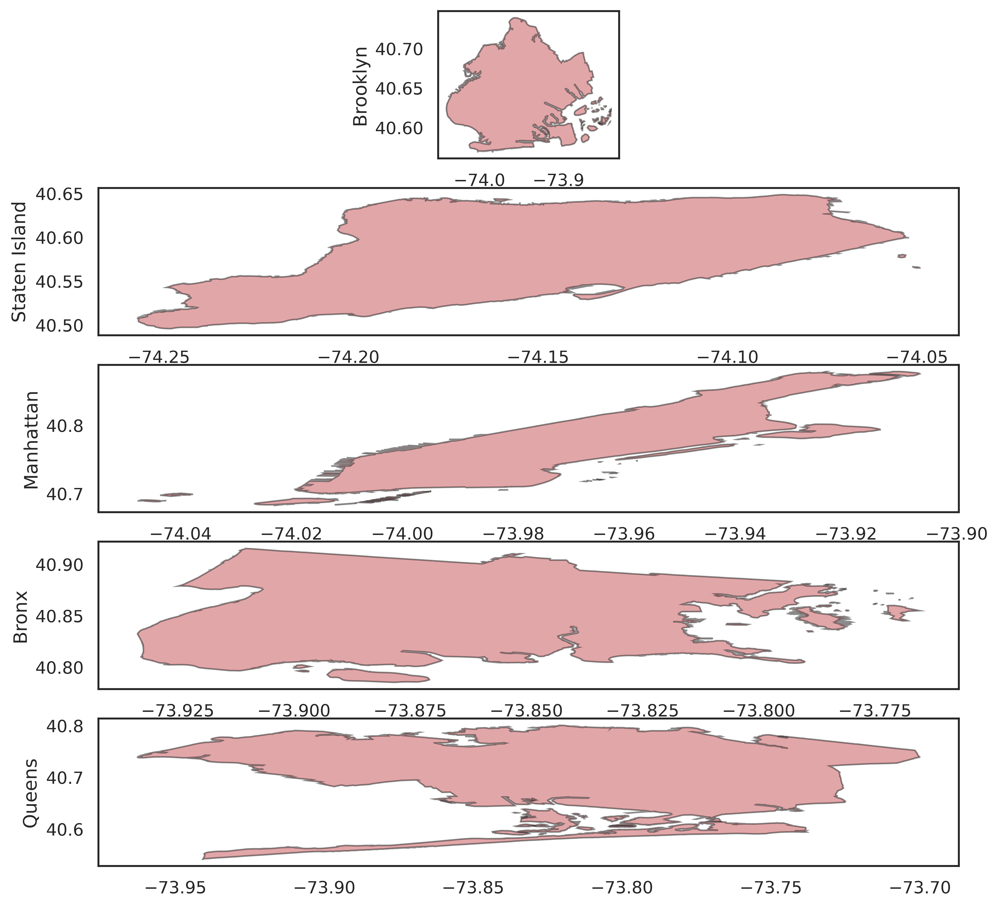

In [43]:
from matplotlib import pyplot

fig, ax = plt.subplots(5, 1, figsize=(10, 10))
for index, multipolygon in enumerate(boro_df.the_geom.unique()):
    for polygon in multipolygon.geoms:
        x, y = polygon.exterior.xy
        ax[index].fill(x, y, alpha=0.5, fc="r", ec="k")
        ax[index].set_ylabel(f"{boro_df.iloc[index].BoroName}")

    # Set aspect ratio and show the plot
    ax[0].set_aspect("equal", adjustable="box")
pyplot.show()

## for each pickup and drop off we will find out to which boro they belong to  according to the boro data we got , and if it does not belong to any region we will just assing it to unknown 


In [44]:
def boro(row, col="pickup"):

    if col == "pickup":
        point = Point(row.pickup_longitude, row.pickup_latitude)
    else:
        point = Point(row.dropoff_longitude, row.dropoff_latitude)

    check = boro_df["the_geom"].apply(lambda x: point.within(x))
    # print(type(boro_df[check]["BoroName"].values))
    # return np.array2string( boro_df[check]["BoroName"].values)
    neighbor = "".join(map(str, boro_df[check]["BoroName"].values))
    return neighbor if neighbor else "unknown"


data["pickup_boro"] = data[["pickup_longitude", "pickup_latitude"]].apply(boro, args=("pickup",), axis=1)

data["dropoff_boro"] = data[["dropoff_longitude", "dropoff_latitude"]].apply(boro, args=("dropoff",), axis=1)

__we can see below that Manhattan has the biggest share among pickup and dropoff out of all Boroughs__ 

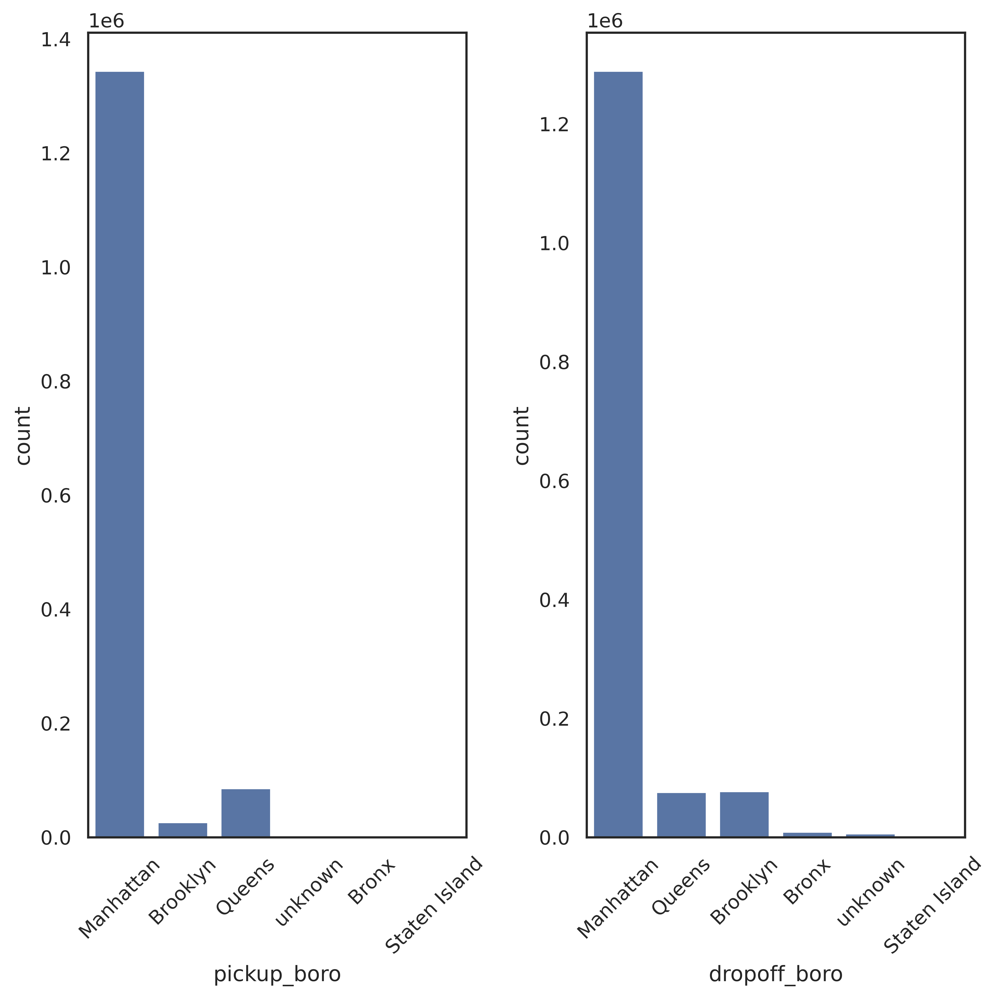

In [45]:
fig, ax = plt.subplots(1, 2, figsize=(8, 8))
sns.countplot(data=data, x="pickup_boro", ax=ax[0])

sns.countplot(data=data, x="dropoff_boro", ax=ax[1])


for ax in ax:
    ax.tick_params(axis="x", rotation=45)

plt.tight_layout()
plt.show()

# let's investigate Traffic volume data 
__an even more useful information would be__  
1. if we know the how busy the streets the dirver is gonna take ( just like how google maps predicts the duration of the trip right!) while is is applicable it's quite challenging i will be leaving this as an extra task for the reader if they prefer to dig int i will just get how busy the boro of the pickup and dropoff
2. another useful information could be the weather in this day


**let's get to work**

In [46]:
traffic_path = "Traffic_Data//Traffic_Volume_Counts_2016.csv"

tf_df = pd.read_csv(traffic_path)
tf_df.head()

,Unnamed: 0,RequestID,Boro,Yr,M,D,HH,MM,Vol,SegmentID,WktGeom,street,fromSt,toSt,Direction
0,1915,23360,Queens,2016,6,13,0,0,7,66303,POINT (1003204.0046622645 209834.15302233098),47 AVENUE,33 Street,34 Street,EB
1,1916,23360,Queens,2016,6,13,0,15,6,66303,POINT (1003204.0046622645 209834.15302233098),47 AVENUE,33 Street,34 Street,EB
2,1917,23360,Queens,2016,6,13,0,30,6,66303,POINT (1003204.0046622645 209834.15302233098),47 AVENUE,33 Street,34 Street,EB
3,1918,23360,Queens,2016,6,13,0,45,7,66303,POINT (1003204.0046622645 209834.15302233098),47 AVENUE,33 Street,34 Street,EB
4,1919,23360,Queens,2016,6,13,1,0,8,66303,POINT (1003204.0046622645 209834.15302233098),47 AVENUE,33 Street,34 Street,EB


___we will calculate the average Vol for each boro in the data and store that into a look up dictionary to use to for later processing___ and for the unknown locations , we will just assing the average of all boro locations to it 

In [47]:
boro_avg_vol = {}

for neighbor in tf_df.Boro.unique():
    df = tf_df[tf_df.Boro == neighbor]
    boro_avg_vol[neighbor] = np.average(df.Vol)
boro_avg_vol["unknown"] = np.average(tuple(boro_avg_vol.values()))

In [48]:
boro_avg_vol

{'Queens': np.float64(145.95423003936895),
 'Manhattan': np.float64(135.14331402887026),
 'Brooklyn': np.float64(88.61496757964132),
 'Staten Island': np.float64(78.52798036465639),
 'Bronx': np.float64(58.7489717453505),
 'unknown': np.float64(101.39789275157749)}

/tmp/ipykernel_233966/1226354331.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=boro_avg_vol.values(), y=boro_avg_vol.keys(), palette="hot", ax=ax)


<Axes: >

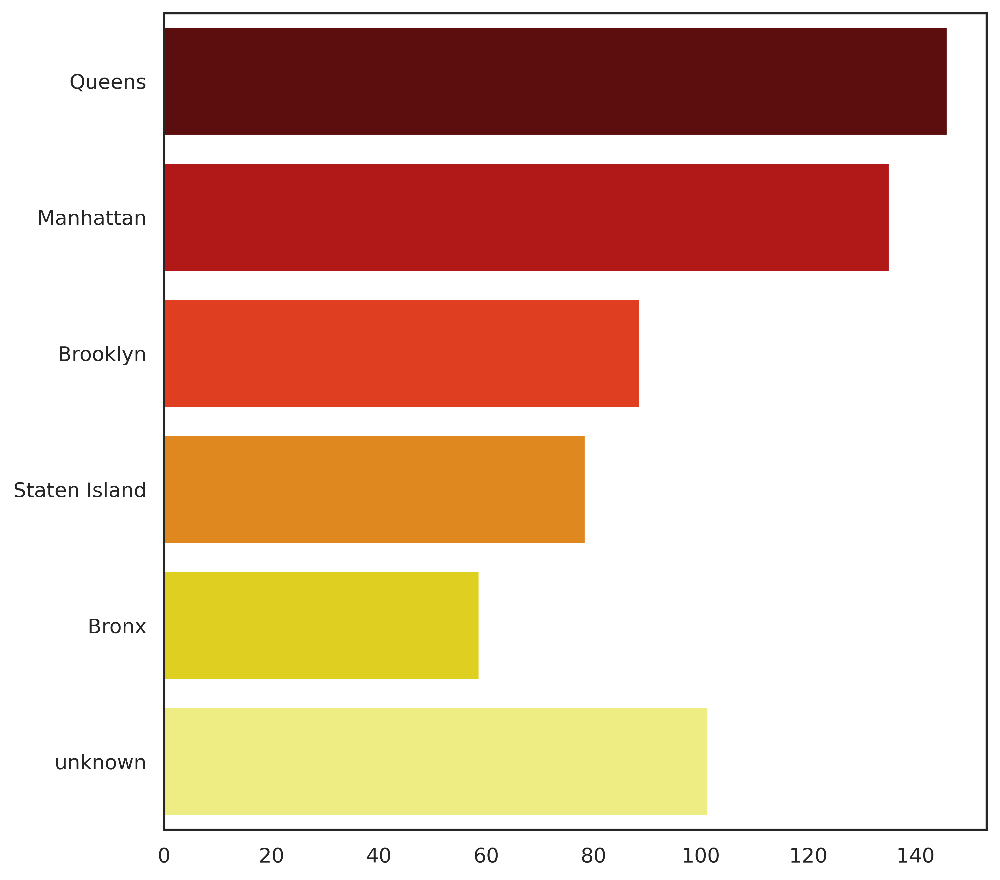

In [49]:
fig, ax = plt.subplots(figsize=(8, 8))
sns.barplot(x=boro_avg_vol.values(), y=boro_avg_vol.keys(), palette="hot", ax=ax)

__we can see according to the data that__ 
- on average Qeens in the most busy one almost neck and neck with Manhattan
- also the unkown neihbor we assigned is quite hight since it's the average of all of them
  
_now let's apply that to our data_

In [50]:
def volume(row, col="pickup_boro"):
    # can be enhanced to get the exact volume by the hour if available
    return boro_avg_vol[row[col]]


data["traffic_volume_pickup"] = data.apply(volume, args=("pickup_boro",), axis=1)
data["traffic_volume_dropoff"] = data.apply(volume, args=("dropoff_boro",), axis=1)

# now for the weather
another huge factor over the trip duration would be the weather condition luckly for use there is a very clean data set for use to use 

and  no need for proccessing just setting the index and adjusting some values and  we are good to go 

__there is a lot of visualiztions and insights can be extracted from this data combined with our orginal data set like for example__
- temperate for each borough location and affect over the trip duration
- snow for each borough location and affect over the tirp duration
-  __you can do this pretty much for every feature in the weather data set as all of them pretty much affect the trip duration like `max temp` , `min temp` , `snow fall` , `snow depth`__

In [51]:
weather_path = "weather data/weather_data_nyc_centralpark_2016(1).csv"
weather_df = pd.read_csv(weather_path)
weather_df.head()

,date,maximum temperature,minimum temperature,average temperature,precipitation,snow fall,snow depth
0,1-1-2016,42,34,38.0,0.00,0.0,0
1,2-1-2016,40,32,36.0,0.00,0.0,0
2,3-1-2016,45,35,40.0,0.00,0.0,0
3,4-1-2016,36,14,25.0,0.00,0.0,0
4,5-1-2016,29,11,20.0,0.00,0.0,0


In [52]:
weather_df.set_index("date", inplace=True)
weather_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 366 entries, 1-1-2016 to 31-12-2016
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   maximum temperature  366 non-null    int64  
 1   minimum temperature  366 non-null    int64  
 2   average temperature  366 non-null    float64
 3   precipitation        366 non-null    object 
 4   snow fall            366 non-null    object 
 5   snow depth           366 non-null    object 
dtypes: float64(1), int64(2), object(3)
memory usage: 20.0+ KB


In [53]:
weather_df.precipitation = weather_df.precipitation.apply(lambda x: float(x) if x != "T" else 0.001)
weather_df["snow fall"] = weather_df["snow fall"].apply(lambda x: float(x) if x != "T" else 0.001)
weather_df["snow depth"] = weather_df["snow depth"].apply(lambda x: float(x) if x != "T" else 0.001)
weather_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 366 entries, 1-1-2016 to 31-12-2016
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   maximum temperature  366 non-null    int64  
 1   minimum temperature  366 non-null    int64  
 2   average temperature  366 non-null    float64
 3   precipitation        366 non-null    float64
 4   snow fall            366 non-null    float64
 5   snow depth           366 non-null    float64
dtypes: float64(4), int64(2)
memory usage: 20.0+ KB


In [54]:
def add_weather_data(row, col="maximum temperature"):
    day = row["day"]
    month = row["month"]
    weather_row = weather_df.loc[f"{int(day)}-{int(month)}-2016"]
    return weather_row[col]


data["max_temp"] = data.apply(add_weather_data, args=("maximum temperature",), axis=1)
data["min_temp"] = data.apply(add_weather_data, args=("minimum temperature",), axis=1)
data["avg_temp"] = data.apply(add_weather_data, args=("average temperature",), axis=1)
data["precipitation"] = data.apply(add_weather_data, args=("precipitation",), axis=1)
data["snow fall"] = data.apply(add_weather_data, args=("snow fall",), axis=1)
data["snow depth"] = data.apply(add_weather_data, args=("snow depth",), axis=1)

# a final look to the correlation matrix  
to see what we have achieved! 
we just need to onehot encode string data to be able to calculate the correlation matrix 

In [55]:
def one_hot_encode(data):
    categories = [["Brooklyn", "Staten Island", "Manhattan", "Bronx", "Queens", "unknown"]]
    encoder = OneHotEncoder(sparse_output=False, categories=categories, dtype=int)
    pickup = encoder.fit_transform(data["pickup_boro"].to_numpy().reshape(-1, 1))
    pick_up_categories = [category + "pickup" for category in categories[0]]
    pickup_df = pd.DataFrame(pickup, columns=pick_up_categories)
    # print(pickup_df.head())

    # drop off
    dropoff = encoder.transform(data["dropoff_boro"].to_numpy().reshape(-1, 1))
    dropoff_categories = [category + "dropoff" for category in categories[0]]
    dropoff_df = pd.DataFrame(dropoff, columns=dropoff_categories)
    # print("drop off ")
    # print(dropoff_df.head())

    return pd.concat([data, pickup_df, dropoff_df], axis=1)


def drop_features(data, features: pd.DataFrame):
    data.drop(features, axis=1, inplace=True)


data = one_hot_encode(data)
drop_features(
    data,
    ["pickup_datetime", "pickup_boro", "dropoff_boro", "store_and_fwd_flag"],
)

In [56]:
data.reindex(sorted(df.columns), axis=1)
corr_matrix = data.corr()
fig, ax = plt.subplots(figsize=(34, 34))
sns.set(font_scale=1)
sns.set_theme(style="white")


# sort the columns of the dataframe
data.reindex(sorted(data.columns), axis=1)
corr_matrix = data.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(
    corr_matrix,
    mask=mask,
    cmap=cmap,
    annot=True,
    vmax=0.3,
    center=0,
    annot_kws={"size": 10},
    fmt="0.2f",
    square=True,
    linewidths=0.5,
    cbar_kws={"shrink": 0.5},
)

<Axes: >

# What could be enhanced 
- better traffic volume information
- extract the average `time/distance` for each boro from, to, for each segment of the day, for example
  - Queens to Manhattan morning
  - Queens to Manhattan afternoon
  - Queent to unkonw evining ...etc
- more granular weather information like wind direction, compare it to the trip direction, etc
- more explicit interaction between variables (I have depended on `PolynomialFeatures` to do the job, which is not ideal)
- filter out some of the features we made
- explore these automatic feature engineering tools
  - [feature tools](https://featuretools.alteryx.com/en/stable/#minute-quick-start)
  - [feature wiz](https://pypi.org/project/featurewiz/0.2.2/)

In [57]:
data.columns

Index(['vendor_id', 'passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'trip_duration', 'month',
       'day', 'hour', 'minute', 'week', 'week_day', 'week_of_year', 'quarter',
       'weekend_status', 'is_holiday', 'hour_sin', 'hour_cos', 'minute_sin',
       'minute_cos', 'week_sin', 'week_cos', 'week_of_year_sin',
       'week_of_year_cos', 'daylight_minutes', 'geo_dist', 'is_rush_hour',
       'passenger_per_geodist', 'h_distance', 'v_distance', 'osrm_distance',
       'osrm_time', 'osrm_implied_speed', 'geo_implied_speed',
       'osrm_dist/geo_dist', 'passenger_per_osrm_dist',
       'traffic_volume_pickup', 'traffic_volume_dropoff', 'max_temp',
       'min_temp', 'avg_temp', 'precipitation', 'snow fall', 'snow depth',
       'Brooklynpickup', 'Staten Islandpickup', 'Manhattanpickup',
       'Bronxpickup', 'Queenspickup', 'unknownpickup', 'Brooklyndropoff',
       'Staten Islanddropoff', 'Manhattandropoff', 'Bronxdropoff',
   